In [1]:
!wget https://download.microsoft.com/download/3/E/1/3E1C3F21-ECDB-4869-8368-6DEBA77B919F/kagglecatsanddogs_5340.zip

--2022-05-25 07:49:26--  https://download.microsoft.com/download/3/E/1/3E1C3F21-ECDB-4869-8368-6DEBA77B919F/kagglecatsanddogs_5340.zip
Resolving download.microsoft.com (download.microsoft.com)... 23.220.188.106, 2600:1402:6800:283::e59, 2600:1402:6800:297::e59
Connecting to download.microsoft.com (download.microsoft.com)|23.220.188.106|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 824887076 (787M) [application/octet-stream]
Saving to: ‘kagglecatsanddogs_5340.zip’

kagglecatsanddogs_5 100%[===================>] 786.67M   144MB/s    in 6.0s    

2022-05-25 07:49:32 (131 MB/s) - ‘kagglecatsanddogs_5340.zip’ saved [824887076/824887076]



unzip

In [2]:
!unzip kagglecatsanddogs_5340.zip

Streaming output truncated to the last 5000 lines.
  inflating: PetImages/Dog/5500.jpg  
  inflating: PetImages/Dog/5501.jpg  
  inflating: PetImages/Dog/5502.jpg  
  inflating: PetImages/Dog/5503.jpg  
  inflating: PetImages/Dog/5504.jpg  
  inflating: PetImages/Dog/5505.jpg  
  inflating: PetImages/Dog/5506.jpg  
  inflating: PetImages/Dog/5507.jpg  
  inflating: PetImages/Dog/5508.jpg  
  inflating: PetImages/Dog/5509.jpg  
  inflating: PetImages/Dog/551.jpg   
  inflating: PetImages/Dog/5510.jpg  
  inflating: PetImages/Dog/5511.jpg  
  inflating: PetImages/Dog/5512.jpg  
  inflating: PetImages/Dog/5513.jpg  
  inflating: PetImages/Dog/5514.jpg  
  inflating: PetImages/Dog/5515.jpg  
  inflating: PetImages/Dog/5516.jpg  
  inflating: PetImages/Dog/5517.jpg  
  inflating: PetImages/Dog/5518.jpg  
  inflating: PetImages/Dog/5519.jpg  
  inflating: PetImages/Dog/552.jpg   
  inflating: PetImages/Dog/5520.jpg  
  inflating: PetImages/Dog/5521.jpg  
  inflating: PetImages/Dog/5522.jpg  

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
import os
import random
from keras.preprocessing.image import load_img
warnings.filterwarnings('ignore')

creating dataframe

In [4]:
input_path=[]
label=[]
for class_name in os.listdir("PetImages"):
  for path in os.listdir("PetImages/"+class_name):
    if class_name=='Cat':
      label.append(0)
    else:
      label.append(1)
    input_path.append(os.path.join("PetImages",class_name,path))
print(input_path[1],label[1])

PetImages/Dog/825.jpg 1


In [5]:
df=pd.DataFrame()
df['images']=input_path
df['label']=label
df=df.sample(frac=1).reset_index(drop=True)
df.head()

,images,label
0,PetImages/Dog/5602.jpg,1
1,PetImages/Cat/11232.jpg,0
2,PetImages/Dog/1000.jpg,1
3,PetImages/Dog/6618.jpg,1
4,PetImages/Dog/955.jpg,1


In [6]:
#deleting non jpg files
for i in df['images']:
  if '.jpg' not in i:
    print(i)

PetImages/Dog/Thumbs.db
PetImages/Cat/Thumbs.db


In [8]:
df=df[df['images']!='PetImages/Dog/Thumbs.db']
df=df[df['images']!='PetImages/Cat/Thumbs.db']
df=df[df['images']!='PetImages/Dog/11702.jpg']
df=df[df['images']!='PetImages/Cat/666.jpg']

len(df)

24998

In [7]:
#some fault images delete them too
import PIL
l=[]
for image in df['images']:
  try:
    img=PIL.Image.open(image)
  except:
    l.append(image)
print(l)

['PetImages/Dog/Thumbs.db', 'PetImages/Cat/Thumbs.db', 'PetImages/Dog/11702.jpg', 'PetImages/Cat/666.jpg']


data analysis

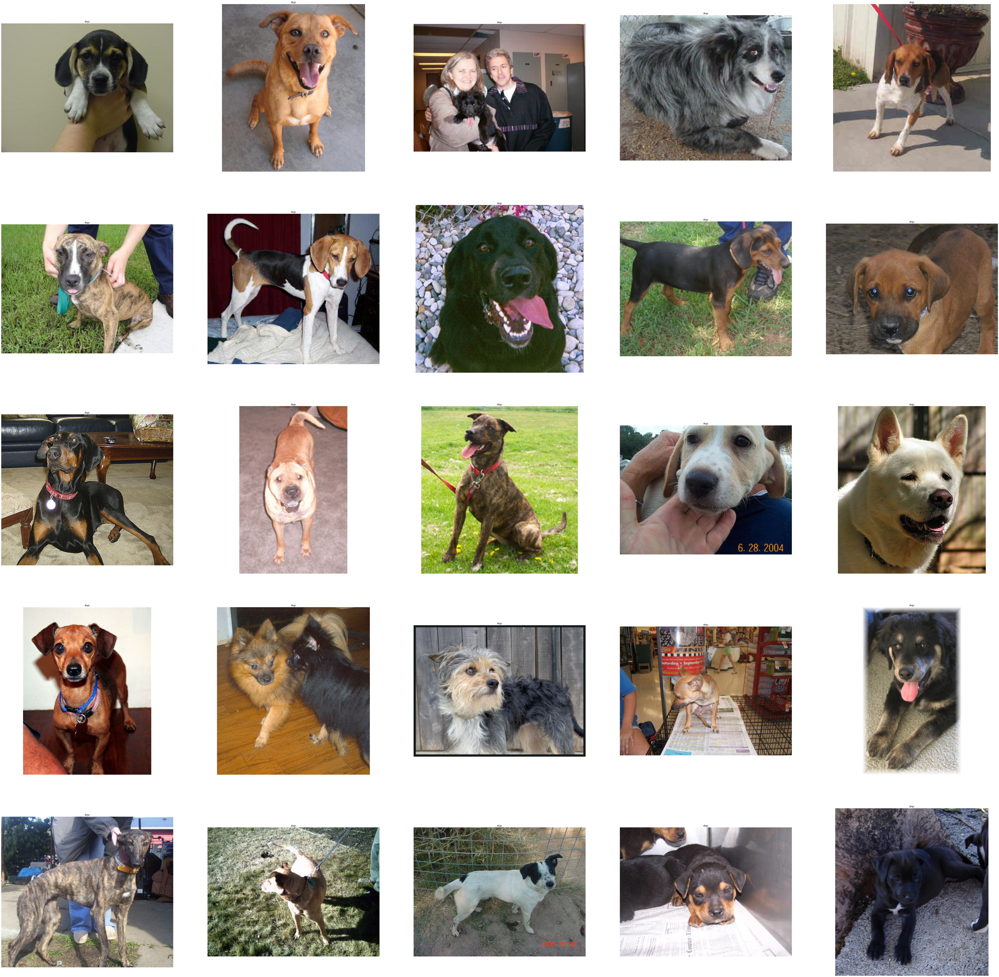

In [9]:
#to display grid of images
plt.figure(figsize=(100,100))
temp=df[df['label']==1]['images']
start=random.randint(0,len(temp))
files=temp[start:start+25]

for index,file in enumerate(files):
  plt.subplot(5,5,index+1)
  img=load_img(file)
  img=np.array(img)
  plt.imshow(img)
  plt.title('dogs')
  plt.axis('off')


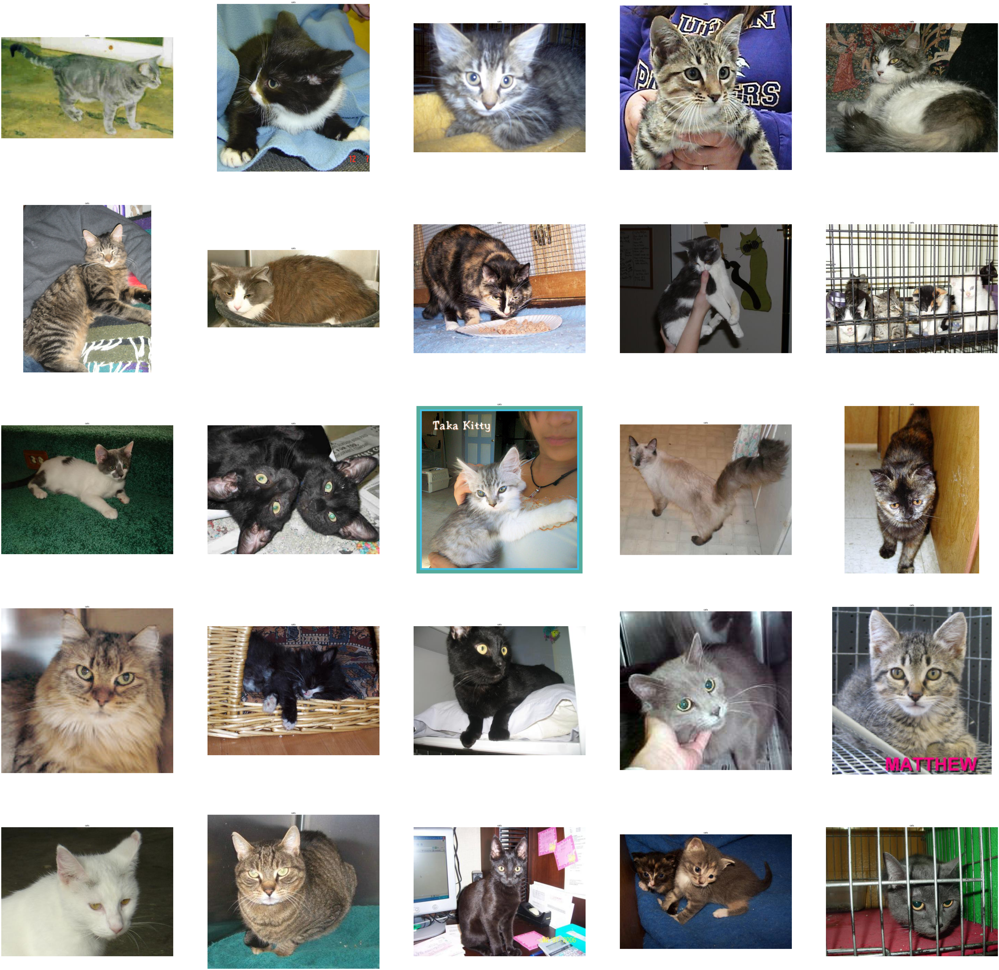

In [10]:
#to display grid of images
plt.figure(figsize=(100,100))
temp=df[df['label']==0]['images']
start=random.randint(0,len(temp))
files=temp[start:start+25]

for index,file in enumerate(files):
  plt.subplot(5,5,index+1)
  img=load_img(file)
  img=np.array(img)
  plt.imshow(img)
  plt.title('cats')
  plt.axis('off')


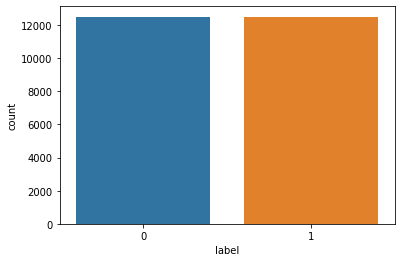

In [11]:
import seaborn as sns
sns.countplot(df['label'])

creating data generator for images

In [12]:
df['label']=df['label'].astype('str')

In [13]:
df.head()

,images,label
0,PetImages/Dog/5602.jpg,1
1,PetImages/Cat/11232.jpg,0
2,PetImages/Dog/1000.jpg,1
3,PetImages/Dog/6618.jpg,1
4,PetImages/Dog/955.jpg,1


In [14]:
#input split 
from sklearn.model_selection import train_test_split
train,test=train_test_split(df,test_size=0.2,random_state=42)

In [15]:
train.head()


,images,label
23289,PetImages/Cat/6914.jpg,0
17784,PetImages/Dog/5225.jpg,1
1020,PetImages/Cat/10518.jpg,0
12646,PetImages/Dog/7176.jpg,1
1533,PetImages/Dog/12372.jpg,1


In [16]:
test.head()

,images,label
6870,PetImages/Cat/113.jpg,0
22913,PetImages/Cat/11765.jpg,0
9670,PetImages/Dog/10405.jpg,1
13640,PetImages/Cat/7603.jpg,0
23340,PetImages/Dog/179.jpg,1


In [17]:
from keras.preprocessing.image import ImageDataGenerator
train_generator=ImageDataGenerator(rescale=1./255,#normalisation of images
                                   rotation_range=40,#augumentation of images to avoid overfitting
                                   shear_range=0.2,
                                   zoom_range=0.2,
                                   horizontal_flip=True,
                                   fill_mode='nearest'
                                   )
val_generator=ImageDataGenerator(rescale=1./255)
train_iterator=train_generator.flow_from_dataframe(train,x_col='images',
                                                   y_col='label',
                                                   target_size=(256,256),
                                                   batch_size=512,
                                                   class_mode='binary')
val_iterator=val_generator.flow_from_dataframe(test,x_col='images',
                                                   y_col='label',
                                                   target_size=(256,256),
                                                   batch_size=512,
                                                   class_mode='binary')

Found 19998 validated image filenames belonging to 2 classes.
Found 5000 validated image filenames belonging to 2 classes.


model creation

In [18]:
from keras import Sequential
from keras.layers import Conv2D,MaxPool2D,Flatten,Dense

In [19]:
model=Sequential([
                  
                  Conv2D(16,(3,3),activation='relu',input_shape=(256,256,3)),
                  MaxPool2D((2,2)),
                  Conv2D(32,(3,3),activation='relu'),
                  MaxPool2D((2,2)),
                  Conv2D(64,(3,3),activation='relu'),
                  MaxPool2D((2,2)),
                  Flatten(),
                  Dense(512,activation='relu'),
                  Dense(1, activation='sigmoid')
])


In [20]:
model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 127, 127, 16)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 62, 62, 32)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 30, 30, 64)       0

In [22]:
# to increase the accuracy increase the epochs

In [21]:

history=model.fit(train_iterator,epochs=10,validation_data=val_iterator)

Epoch 1/10
40/40 [==============================] - 319s 8s/step - loss: 0.9570 - accuracy: 0.5867 - val_loss: 0.6049 - val_accuracy: 0.6844
Epoch 2/10
40/40 [==============================] - 305s 8s/step - loss: 0.6035 - accuracy: 0.6741 - val_loss: 0.5636 - val_accuracy: 0.7164
Epoch 3/10
40/40 [==============================] - 304s 8s/step - loss: 0.5728 - accuracy: 0.7008 - val_loss: 0.5416 - val_accuracy: 0.7212
Epoch 4/10
40/40 [==============================] - 307s 8s/step - loss: 0.5427 - accuracy: 0.7300 - val_loss: 0.5194 - val_accuracy: 0.7460
Epoch 5/10
40/40 [==============================] - 304s 8s/step - loss: 0.5198 - accuracy: 0.7422 - val_loss: 0.4898 - val_accuracy: 0.7684
Epoch 6/10
40/40 [==============================] - 304s 8s/step - loss: 0.4980 - accuracy: 0.7563 - val_loss: 0.4754 - val_accuracy: 0.7656
Epoch 7/10
40/40 [==============================] - 304s 8s/step - loss: 0.4901 - accuracy: 0.7630 - val_loss: 0.4790 - val_accuracy: 0.7722
Epoch 8/10
40

<Figure size 432x288 with 0 Axes>

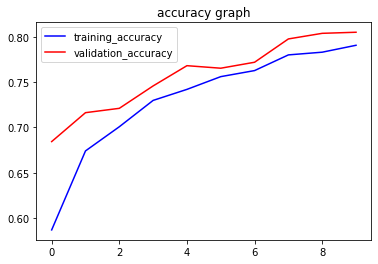

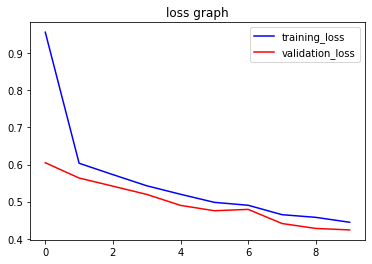

<Figure size 432x288 with 0 Axes>

In [23]:

#visualization
accuracy=history.history['accuracy']
val_accuracy=history.history['val_accuracy']
epochs=range(len(accuracy))

plt.plot(epochs,accuracy,'b',label='training_accuracy')


plt.plot(epochs,val_accuracy,'r',label='validation_accuracy')
plt.title('accuracy graph')
plt.legend()
plt.figure()

loss=history.history['loss']
val_loss=history.history['val_loss']

plt.plot(epochs,loss,'b',label='training_loss')
plt.plot(epochs,val_loss,'r',label='validation_loss')
plt.title('loss graph')
plt.legend()
plt.figure()